In [40]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer
from sklearn.metrics import f1_score
import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import mean_absolute_error
import warnings
import plotly.express as px
from sklearn import metrics
from category_encoders import OneHotEncoder
from sklearn.metrics import make_scorer
from sklearn.metrics import mean_squared_error as mse
from ipywidgets import Dropdown, FloatSlider, IntSlider, interact
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
from sklearn.utils.validation import check_is_fitted
warnings.simplefilter(action="ignore", category=FutureWarning)

In [3]:
df_1 = pd.read_csv("pricestimator_proversion.csv")

In [4]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 720195 entries, 0 to 720194
Data columns (total 12 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   listing_uid                          720195 non-null  int64  
 1   listing_name                         720195 non-null  object 
 2   builder_name                         720195 non-null  object 
 3   property_type_name                   717037 non-null  object 
 4   locality_name                        720195 non-null  object 
 5   city_name                            720195 non-null  object 
 6   listing_lat                          713235 non-null  float64
 7   listing_long                         713177 non-null  float64
 8   listing_created_date                 720195 non-null  object 
 9   unit_summary_history_bedrooms        675979 non-null  float64
 10  listing_unit_summary_area            701727 non-null  float64
 11  listing_unit_

In [5]:
df = df_1.loc[df_1['city_name'] == "Chennai"]

In [6]:
df.head()

,listing_uid,listing_name,builder_name,property_type_name,locality_name,city_name,listing_lat,listing_long,listing_created_date,unit_summary_history_bedrooms,listing_unit_summary_area,listing_unit_summary_price_per_sqft
0,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,939.0,4500.0
1,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,993.0,4500.0
2,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,1336.0,4500.0
3,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,2.0,939.0,4500.0
4,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,2.0,993.0,4500.0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 142612 entries, 0 to 720168
Data columns (total 12 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   listing_uid                          142612 non-null  int64  
 1   listing_name                         142612 non-null  object 
 2   builder_name                         142612 non-null  object 
 3   property_type_name                   140917 non-null  object 
 4   locality_name                        142612 non-null  object 
 5   city_name                            142612 non-null  object 
 6   listing_lat                          139468 non-null  float64
 7   listing_long                         139469 non-null  float64
 8   listing_created_date                 142612 non-null  object 
 9   unit_summary_history_bedrooms        126960 non-null  float64
 10  listing_unit_summary_area            136104 non-null  float64
 11  listing_unit_

In [8]:
df = df.dropna()

In [9]:
df = df[ (df['listing_unit_summary_price_per_sqft'] < 24000)]

In [10]:
df = df[ (df["listing_unit_summary_area"] < 15000)]

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 125366 entries, 0 to 719898
Data columns (total 12 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   listing_uid                          125366 non-null  int64  
 1   listing_name                         125366 non-null  object 
 2   builder_name                         125366 non-null  object 
 3   property_type_name                   125366 non-null  object 
 4   locality_name                        125366 non-null  object 
 5   city_name                            125366 non-null  object 
 6   listing_lat                          125366 non-null  float64
 7   listing_long                         125366 non-null  float64
 8   listing_created_date                 125366 non-null  object 
 9   unit_summary_history_bedrooms        125366 non-null  float64
 10  listing_unit_summary_area            125366 non-null  float64
 11  listing_unit_

In [12]:
df["property_price"] = df["listing_unit_summary_price_per_sqft"]*df["listing_unit_summary_area"]
df.head()

,listing_uid,listing_name,builder_name,property_type_name,locality_name,city_name,listing_lat,listing_long,listing_created_date,unit_summary_history_bedrooms,listing_unit_summary_area,listing_unit_summary_price_per_sqft,property_price
0,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,939.0,4500.0,4225500.0
1,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,993.0,4500.0,4468500.0
2,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,3.0,1336.0,4500.0,6012000.0
3,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,2.0,939.0,4500.0,4225500.0
4,1,Acchyuthan's Shivam,Acchyuthan Builders,Apartment/Flat,Tambaram West,Chennai,12.92572,80.117406,2015-06-30 19:57:08,2.0,993.0,4500.0,4468500.0


In [13]:
test = df.groupby("locality_name")["listing_uid"].nunique()
test = test.sort_values(ascending=False)
test.tail(70)

locality_name
Kandanchavadi       8
Kodungaiyur         8
Nolambur            7
Nallambakkam        7
Taramani            7
                   ..
Kovilancheri        1
Korukkupet          1
Karumbakkam         1
Karayanchavadi      1
Zamin Pallavaram    1
Name: listing_uid, Length: 70, dtype: int64

In [14]:
fig = px.scatter_mapbox(
    df,
    lat= "listing_lat",
    lon= "listing_long",
    width=600,  
    height=600,
    color="property_price",
    hover_data=["property_price"],
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()

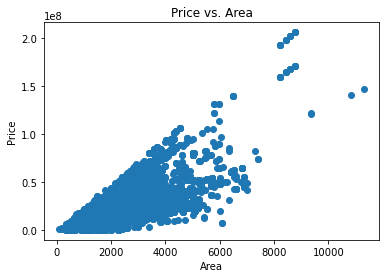

In [15]:
plt.scatter(x=df["listing_unit_summary_area"], y=df["property_price"])
plt.xlabel("Area")
plt.ylabel("Price")
plt.title("Price vs. Area");

In [37]:
target = "property_price"
y_train = df[target]
features =["listing_lat","listing_long","listing_unit_summary_area",'locality_name']
X_train = df[features]

In [31]:
feature = 'property_price'
X_train = df[['listing_unit_summary_area', 'locality_name']]
y_train = df[feature]

In [32]:
y_mean = y_train.mean()
y_pred_baseline = [y_mean] * len(y_train)
baseline_mae = mean_absolute_error(y_train, y_pred_baseline)
print("Mean apt price:", y_mean)
print("Baseline MAE:", baseline_mae)

Mean apt price: 6962979.5843290845
Baseline MAE: 3815687.1436135494


In [33]:
model = make_pipeline(
    OneHotEncoder(use_cat_names = True), 
    SimpleImputer(),
    RandomForestRegressor(n_estimators = 25)
)
model.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['locality_name'], use_cat_names=True)),
                ('simpleimputer', SimpleImputer()),
                ('randomforestregressor',
                 RandomForestRegressor(n_estimators=25))])

In [34]:
y_pred_training = model.predict(X_train)
print("Training MAE:", mean_absolute_error(y_train, y_pred_training))

Training MAE: 453545.749186626


In [35]:
def make_prediction(Area, Locality):
    data = {
        "listing_unit_summary_area": Area,
        "locality_name": Locality
    }
    df = pd.DataFrame(data, index=[0])
    prediction = model.predict(df).round(2)[0]
    return f"Predicted apartment price: Rs.{prediction}"

In [36]:
make_prediction(1310, "Anna Nagar")

'Predicted apartment price: Rs.19163336.67'

In [38]:
interact(
    make_prediction,
    Area=IntSlider(
        min=X_train["listing_unit_summary_area"].min(),
        max=X_train["listing_unit_summary_area"].max(),
        value=X_train["listing_unit_summary_area"].mean(),
    ),
    Locality=Dropdown(options=sorted(X_train["locality_name"].unique())),
);


interactive(children=(IntSlider(value=1187, description='Area', max=11300, min=100), Dropdown(description='Loc…

In [41]:
feature = 'property_price'
x = df[['listing_unit_summary_area', 'locality_name']]
y = df[feature]

In [42]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, random_state = 42)

In [45]:
model_1 = make_pipeline(
    OneHotEncoder(use_cat_names = True), 
    SimpleImputer(),
    DecisionTreeRegressor()
)
model_1.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['locality_name'], use_cat_names=True)),
                ('simpleimputer', SimpleImputer()),
                ('decisiontreeregressor', DecisionTreeRegressor())])

In [46]:
y_pred_dtc = model_1.predict(X_test)
print('Pred Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred_dtc))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred_dtc))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred_dtc)))

Pred Mean Absolute Error: 633450.7304210074
Mean Squared Error: 3371347381018.019
Root Mean Squared Error: 1836122.9209990324


In [47]:
model_2 = make_pipeline(
    OneHotEncoder(use_cat_names = True), 
    SimpleImputer(),
    KNN(n_neighbors = 2)
)
model_2.fit(X_train, y_train)

Pipeline(steps=[('onehotencoder',
                 OneHotEncoder(cols=['locality_name'], use_cat_names=True)),
                ('simpleimputer', SimpleImputer()),
                ('kneighborsregressor', KNeighborsRegressor(n_neighbors=2))])

In [48]:
test_predict = model_2.predict(X_test)
print('Pred Mean Absolute Error:', metrics.mean_absolute_error(y_test, test_predict))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, test_predict))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, test_predict)))

Pred Mean Absolute Error: 996249.2571469593
Mean Squared Error: 7839762196903.482
Root Mean Squared Error: 2799957.53483932
